In [1]:
!pip install imageio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 21.5 MB/s eta 0:00:00a 0:00:01


<div style="background-color: #4CAF50; padding: 10px; text-align: center; color: white; border-radius: 5px;">
  <h2 style="font-family: 'Arial', sans-serif; margin: 0;">
    Importing Libraries
  </h2>
</div>

In [2]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import random
import os
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import imageio
from tqdm import tqdm

  <h2 style="font-family: 'Arial', sans-serif; margin: 0;">
    Preparing Data
  </h2>

In [ ]:
 def load_images(directory, image_size=(64, 64)):
    images = []
    for filename in os.listdir(directory):
        try:
            img_path = os.path.join(directory, filename)
            img = load_img(img_path, target_size=image_size)
            img_array = img_to_array(img)
            images.append(img_array)
        except (IOError, OSError):
            continue
    images = np.array(images)
    images = (images - 127.5) / 127.5  
    return images

import kagglehub

# Download latest version
path = kagglehub.dataset_download("shaunthesheep/microsoft-catsvsdogs-dataset")


images = load_images(dataset_directory)

 95%|█████████▍| 747M/788M [07:05<01:43, 412kB/s]  

In [37]:
len(images)

NameError: name 'images' is not defined

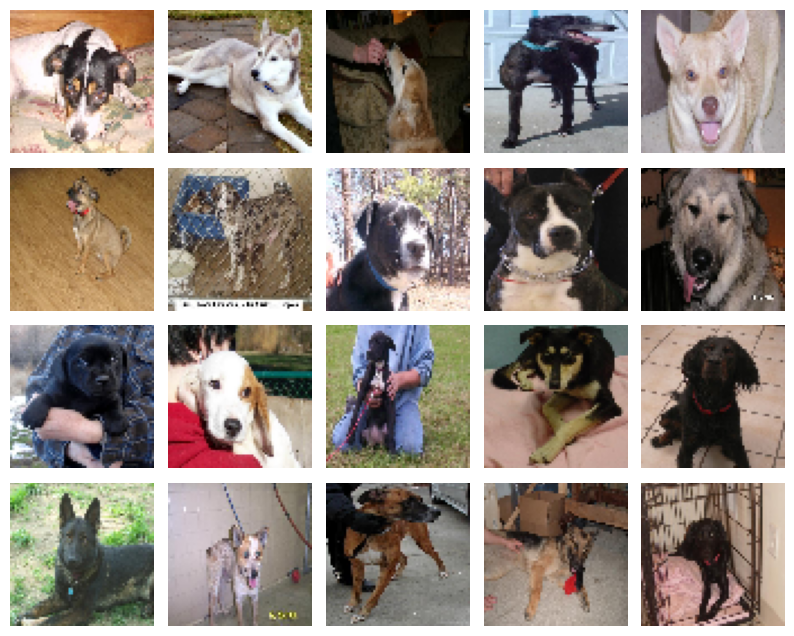

In [ ]:
rows = 4
cols = 5

plt.figure(figsize=(cols*2, rows*2))

for i in range(rows * cols):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(images[i] * 0.5 + 0.5)
    plt.axis('off')

plt.subplots_adjust(wspace=0.1, hspace=0.1) 
plt.show()

  <h2 style="font-family: 'Arial', sans-serif; margin: 0;">
    Building the Generator Model
  </h2>


In [ ]:
def build_generator():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Reshape((8, 8, 256)))
    assert model.output_shape == (None, 8, 8, 256)
    
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    assert model.output_shape == (None, 16, 16, 128)
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    assert model.output_shape == (None, 32, 32, 64)
    
    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 3)
    
    return model

generator = build_generator()
generator.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 16384)          │     1,638,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 16384)          │        65,536 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 128)    │       819,200 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 64)     │       204,800 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 3)      │         4,800 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,733,504 (10.43 MB)

 Trainable params: 2,700,352 (10.30 MB)

 Non-trainable params: 33,152 (129.50 KB)

**The generator model starts with a dense layer and then uses a series of transposed convolutional layers to upsample the input noise vector into a 64x64x3 image.**

### Summary
- The generator transforms a 100-dimensional noise vector into a 64x64x3 image through a series of upsampling steps using transposed convolutions.
- Batch normalization and Leaky ReLU activations are used to stabilize training and introduce non-linearity.
- The final layer uses `tanh` activation to scale the output to the range [-1, 1], suitable for image data.

# Discriminator

In [ ]:
def build_discriminator():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[64, 64, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    model.add(layers.Flatten())
    model.add(layers.Dense(1))
    
    return model

discriminator = build_discriminator()
discriminator.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 32, 32, 64)     │         4,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 16, 16, 128)    │       204,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │        32,769 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 242,561 (947.50 KB)

 Trainable params: 242,561 (947.50 KB)

 Non-trainable params: 0 (0.00 B)

**The discriminator model is designed to take an image input and output a single value representing the probability that the input image is real (as opposed to generated by the generator).**

### Summary
- The discriminator takes a 64x64x3 image as input.
- It uses two convolutional layers with Leaky ReLU activations and Dropout to extract features and prevent overfitting.
- The Flatten layer converts the 3D feature maps into a 1D vector.
- The final Dense layer outputs a single value, which is used to determine whether the input image is real or generated.


  <h2 style="font-family: 'Arial', sans-serif; margin: 0;">
    Compiling and Training the Model
  </h2>


In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

# We will reuse this seed over time to visualize progress
seed = tf.random.normal([16, noise_dim])

seed

<tf.Tensor: shape=(16, 100), dtype=float32, numpy=
array([[-0.20710577, -0.6099092 , -1.0753692 , ..., -0.16427012,
         0.30983573,  0.2064876 ],
       [-1.6763409 ,  0.6895782 , -0.403753  , ...,  1.5915115 ,
         0.64908653, -0.23806079],
       [ 0.6069496 , -0.73224425,  0.03061864, ..., -0.4801806 ,
        -0.11863096, -0.3774986 ],
       ...,
       [ 0.89393866, -0.13619114,  0.8743541 , ..., -0.6995993 ,
         2.096129  ,  0.11340056],
       [ 1.3201542 ,  0.5541675 ,  0.87625706, ..., -0.45760894,
        -2.8245502 , -0.25064775],
       [-1.6487392 ,  0.7939768 ,  0.6152296 , ...,  1.1976676 ,
        -0.5673165 ,  0.6692776 ]], dtype=float32)>

In [ ]:
@tf.function
def train_step(images):
    noise = tf.random.normal([images.shape[0], noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(4, 4))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow((predictions[i].numpy() * 127.5 + 127.5).astype(np.uint8))
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

In [ ]:
def train(dataset, epochs):
    for epoch in tqdm(range(epochs)):
        for image_batch in dataset:
            train_step(image_batch)

        if (epoch + 1) % 10 == 0:
            generate_and_save_images(generator, epoch + 1, seed)

        if (epoch + 1) % 15 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

    generate_and_save_images(generator, epochs, seed)

  1%|          | 9/1000 [00:55<1:26:00,  5.21s/it]

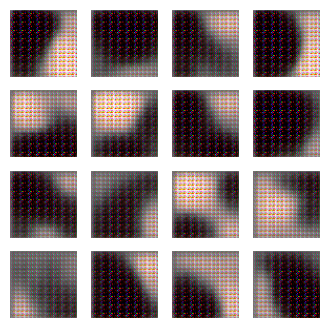

  2%|▏         | 19/1000 [01:46<1:22:31,  5.05s/it]

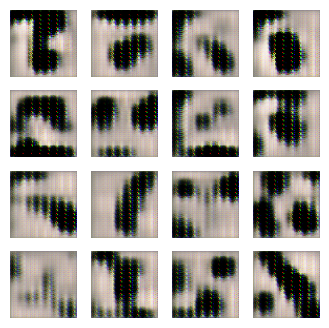

  3%|▎         | 29/1000 [02:37<1:21:25,  5.03s/it]

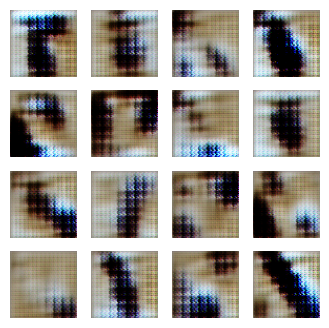

  4%|▍         | 39/1000 [03:28<1:20:38,  5.03s/it]

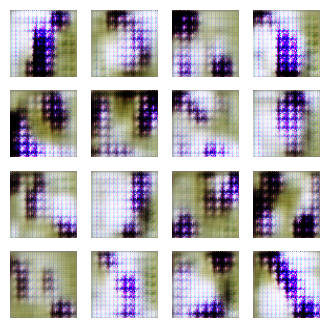

  5%|▍         | 49/1000 [04:19<1:19:51,  5.04s/it]

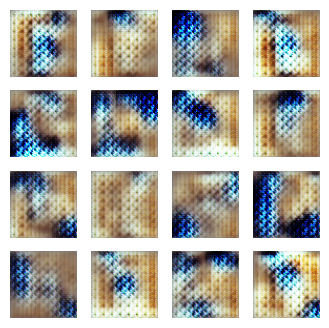

  6%|▌         | 59/1000 [05:10<1:18:53,  5.03s/it]

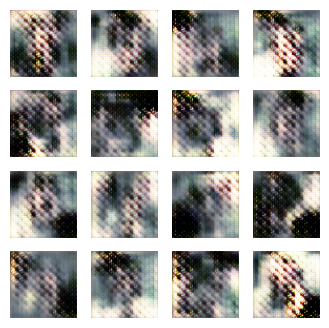

  7%|▋         | 69/1000 [06:01<1:18:04,  5.03s/it]

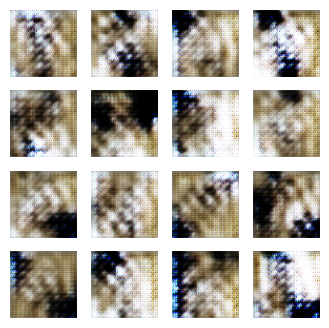

  8%|▊         | 79/1000 [06:52<1:17:24,  5.04s/it]

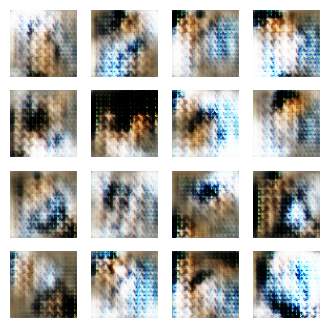

  9%|▉         | 89/1000 [07:43<1:16:24,  5.03s/it]

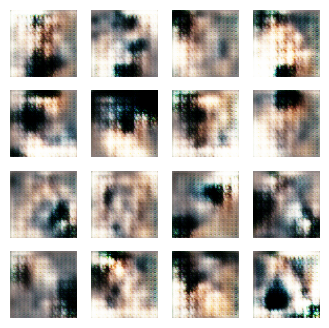

 10%|▉         | 99/1000 [08:34<1:15:29,  5.03s/it]

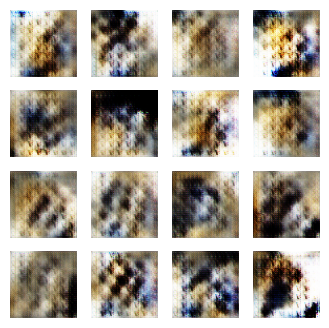

 11%|█         | 109/1000 [09:25<1:14:48,  5.04s/it]

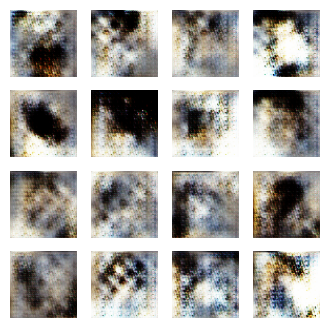

 12%|█▏        | 119/1000 [10:16<1:13:52,  5.03s/it]

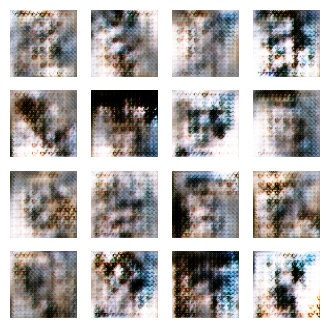

 13%|█▎        | 129/1000 [11:07<1:13:06,  5.04s/it]

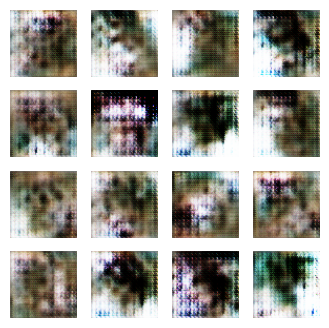

 14%|█▍        | 139/1000 [11:58<1:12:16,  5.04s/it]

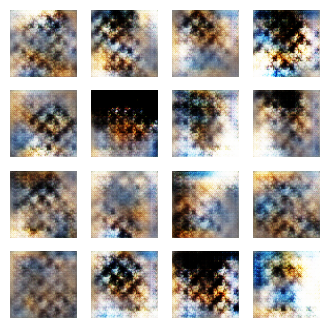

 15%|█▍        | 149/1000 [12:49<1:11:17,  5.03s/it]

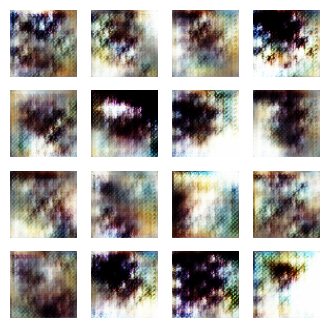

 16%|█▌        | 159/1000 [13:40<1:10:32,  5.03s/it]

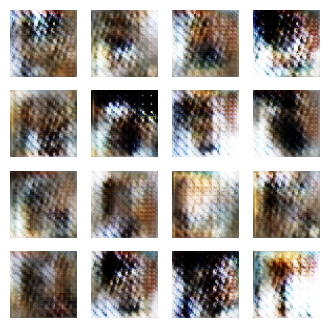

 17%|█▋        | 169/1000 [14:31<1:09:49,  5.04s/it]

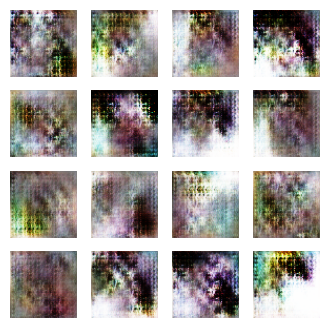

 18%|█▊        | 179/1000 [15:22<1:08:49,  5.03s/it]

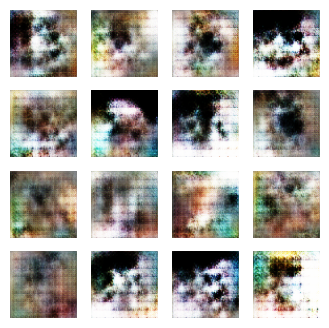

 19%|█▉        | 189/1000 [16:13<1:08:00,  5.03s/it]

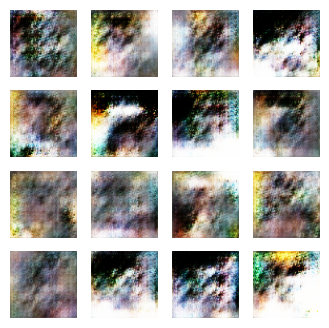

 20%|█▉        | 199/1000 [17:04<1:07:12,  5.03s/it]

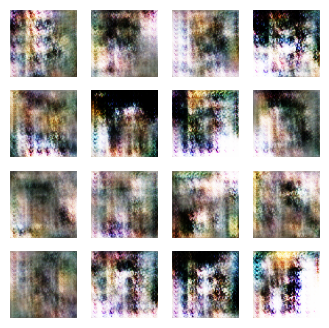

 21%|██        | 209/1000 [17:55<1:06:21,  5.03s/it]

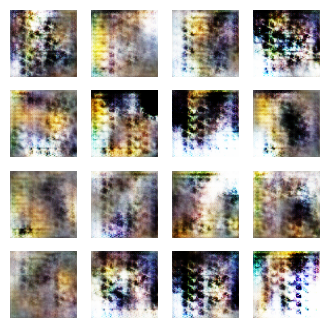

 22%|██▏       | 219/1000 [18:46<1:05:29,  5.03s/it]

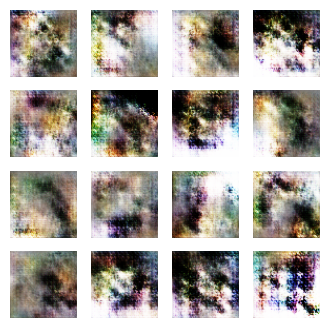

 23%|██▎       | 229/1000 [19:37<1:04:43,  5.04s/it]

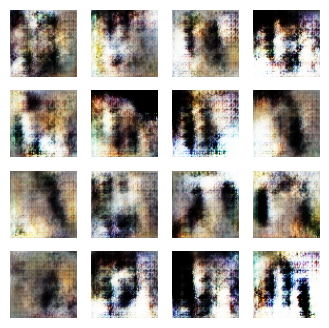

 24%|██▍       | 239/1000 [20:28<1:03:49,  5.03s/it]

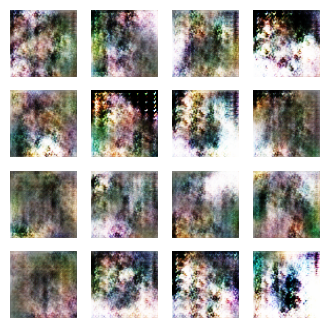

 25%|██▍       | 249/1000 [21:19<1:02:57,  5.03s/it]

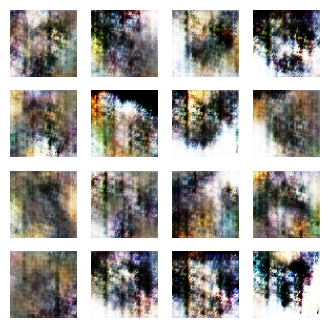

 26%|██▌       | 259/1000 [22:10<1:02:13,  5.04s/it]

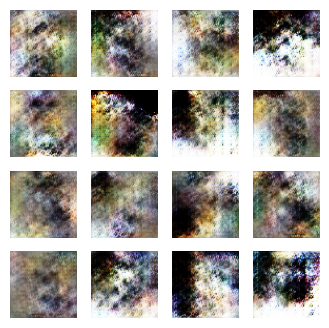

 27%|██▋       | 269/1000 [23:01<1:01:16,  5.03s/it]

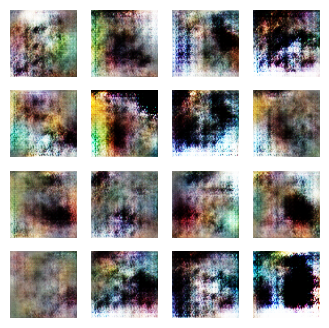

 28%|██▊       | 279/1000 [23:52<1:00:27,  5.03s/it]

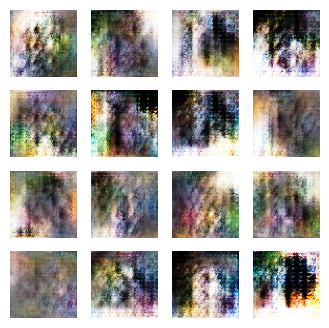

 29%|██▉       | 289/1000 [24:43<59:41,  5.04s/it]  

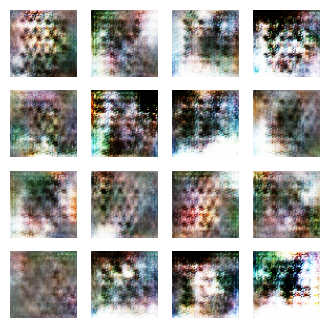

 30%|██▉       | 299/1000 [25:34<58:46,  5.03s/it]  

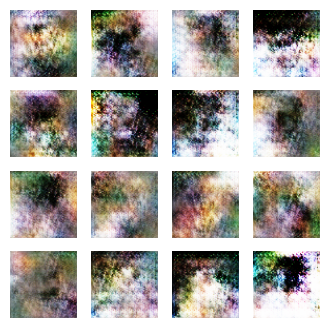

 31%|███       | 309/1000 [26:25<57:56,  5.03s/it]  

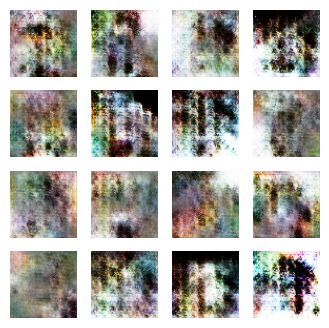

 32%|███▏      | 319/1000 [27:16<57:10,  5.04s/it]  

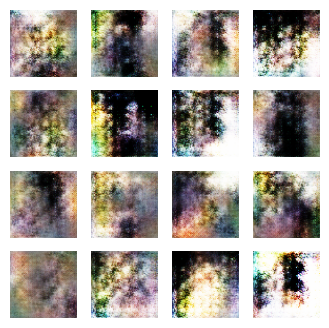

 33%|███▎      | 329/1000 [28:06<56:13,  5.03s/it]

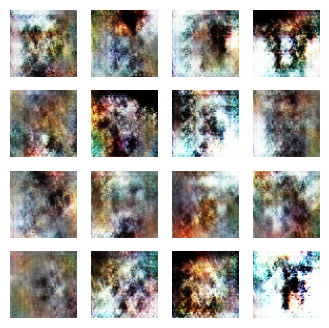

 34%|███▍      | 339/1000 [28:58<55:27,  5.03s/it]

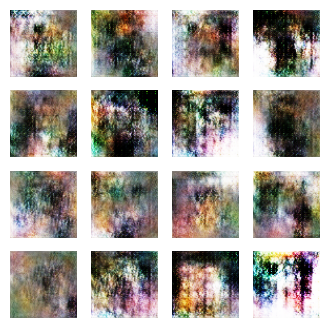

 35%|███▍      | 349/1000 [29:48<54:33,  5.03s/it]

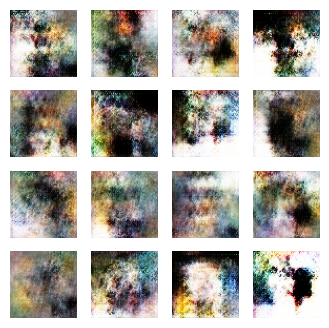

 36%|███▌      | 359/1000 [30:39<53:37,  5.02s/it]

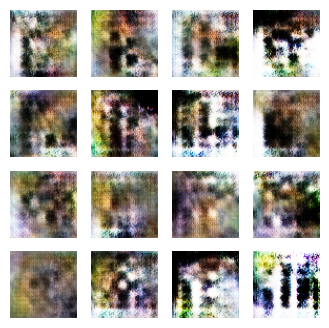

 37%|███▋      | 369/1000 [31:30<52:48,  5.02s/it]

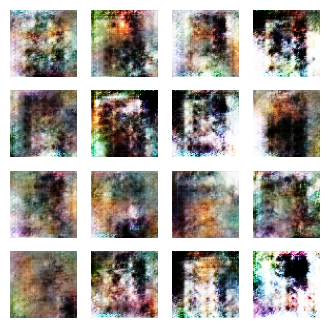

 38%|███▊      | 379/1000 [32:21<52:00,  5.02s/it]

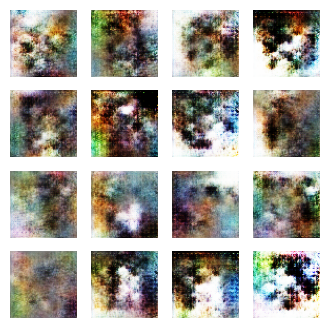

 39%|███▉      | 389/1000 [33:12<51:09,  5.02s/it]

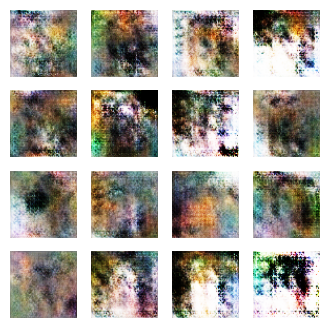

 40%|███▉      | 399/1000 [34:03<50:17,  5.02s/it]

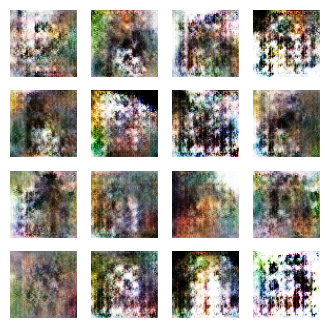

 41%|████      | 409/1000 [34:54<49:29,  5.03s/it]

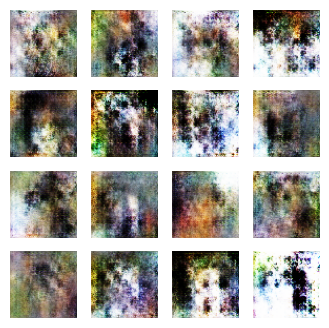

 42%|████▏     | 419/1000 [35:44<48:35,  5.02s/it]

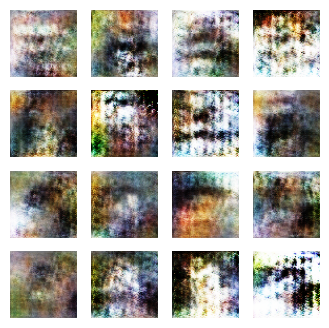

 43%|████▎     | 429/1000 [36:36<47:48,  5.02s/it]

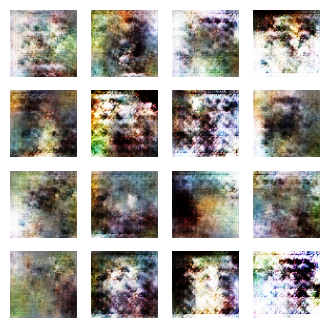

 44%|████▍     | 439/1000 [37:26<46:59,  5.03s/it]

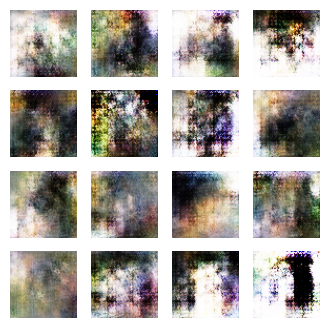

 45%|████▍     | 449/1000 [38:17<46:06,  5.02s/it]

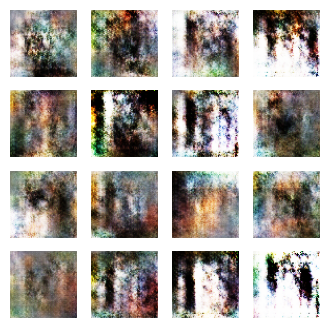

 46%|████▌     | 459/1000 [39:08<45:15,  5.02s/it]

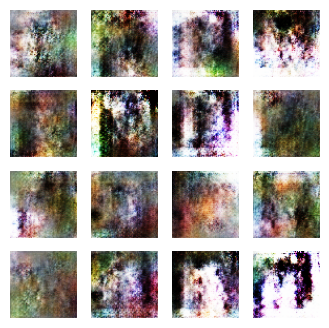

 47%|████▋     | 469/1000 [39:59<44:30,  5.03s/it]

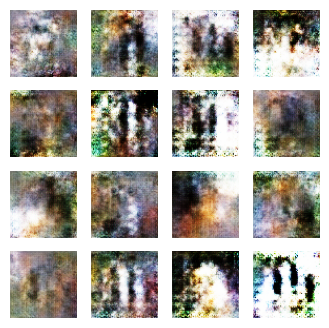

 48%|████▊     | 479/1000 [40:50<43:34,  5.02s/it]

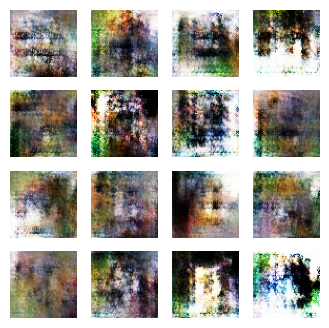

 49%|████▉     | 489/1000 [41:41<42:44,  5.02s/it]

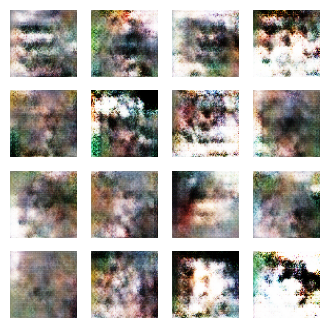

 50%|████▉     | 499/1000 [42:31<41:57,  5.03s/it]

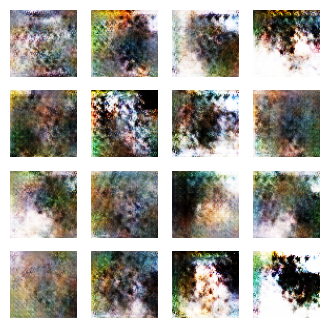

 51%|█████     | 509/1000 [43:22<41:04,  5.02s/it]

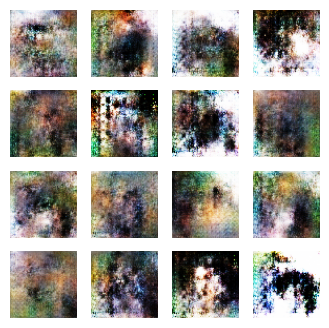

 52%|█████▏    | 519/1000 [44:13<40:16,  5.02s/it]

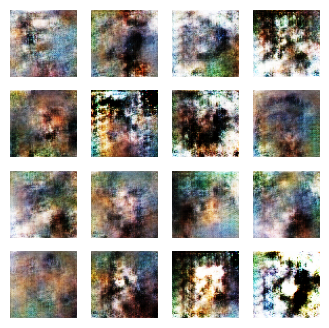

 53%|█████▎    | 529/1000 [45:04<39:27,  5.03s/it]

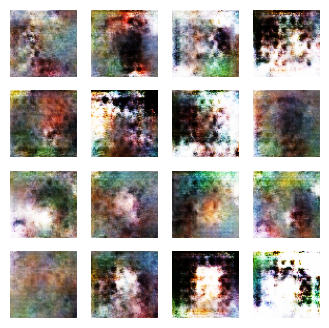

 54%|█████▍    | 539/1000 [45:55<38:33,  5.02s/it]

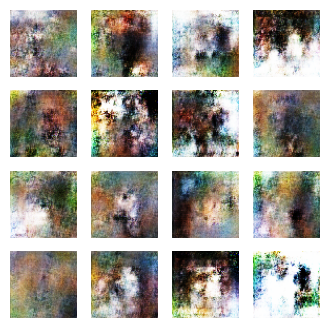

 55%|█████▍    | 549/1000 [46:46<37:43,  5.02s/it]

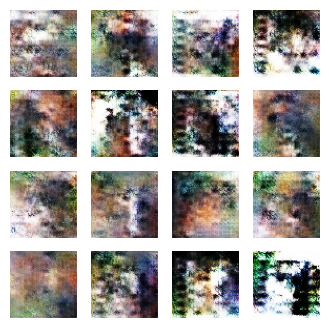

 56%|█████▌    | 559/1000 [47:37<37:04,  5.04s/it]

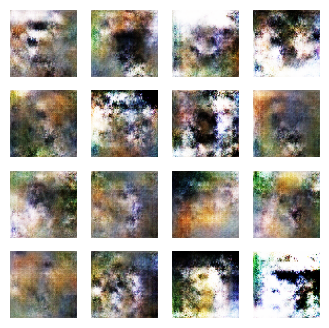

 57%|█████▋    | 569/1000 [48:27<36:03,  5.02s/it]

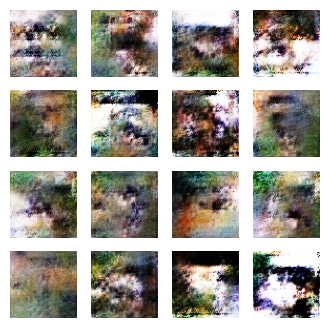

 58%|█████▊    | 579/1000 [49:18<35:14,  5.02s/it]

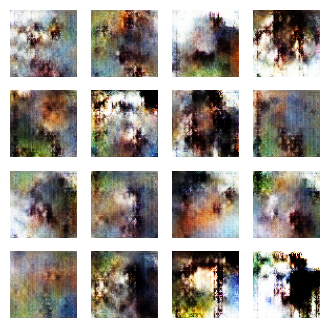

 59%|█████▉    | 589/1000 [50:09<34:25,  5.03s/it]

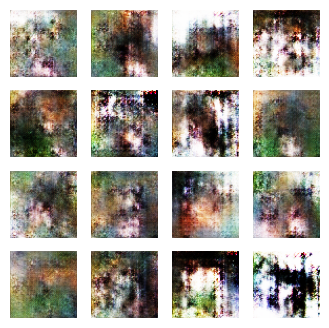

 60%|█████▉    | 599/1000 [51:00<33:32,  5.02s/it]

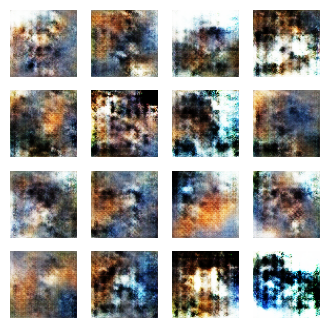

 61%|██████    | 609/1000 [51:51<32:43,  5.02s/it]

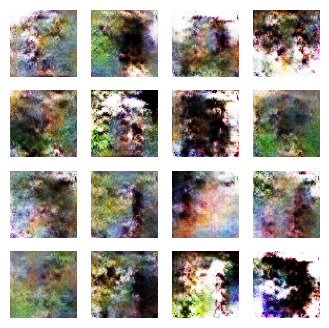

 62%|██████▏   | 619/1000 [52:42<31:54,  5.02s/it]

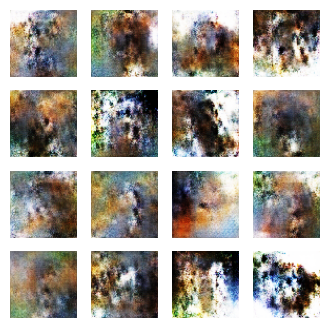

 63%|██████▎   | 629/1000 [53:32<31:02,  5.02s/it]

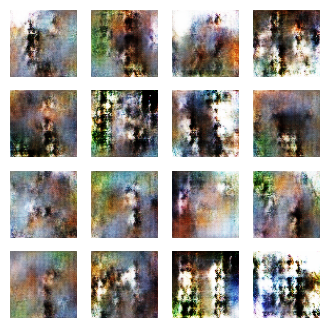

 64%|██████▍   | 639/1000 [54:23<30:12,  5.02s/it]

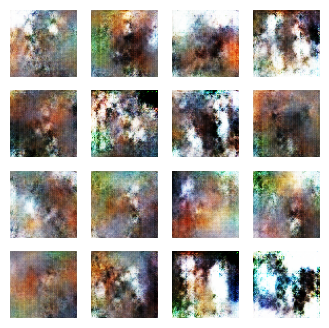

 65%|██████▍   | 649/1000 [55:14<29:25,  5.03s/it]

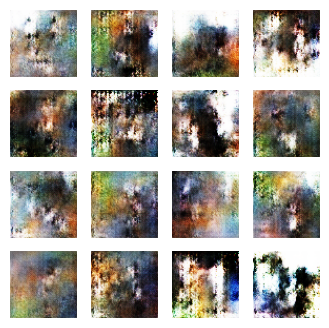

 66%|██████▌   | 659/1000 [56:05<28:31,  5.02s/it]

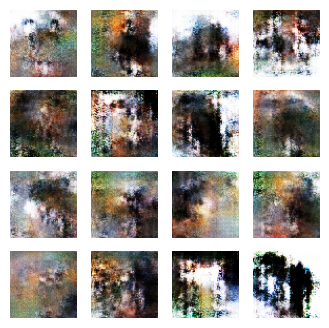

 67%|██████▋   | 669/1000 [56:56<27:41,  5.02s/it]

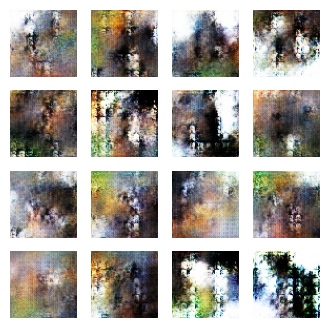

 68%|██████▊   | 679/1000 [57:47<26:53,  5.03s/it]

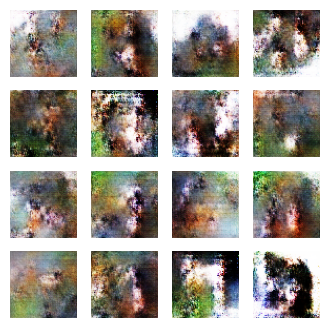

 69%|██████▉   | 689/1000 [58:38<26:01,  5.02s/it]

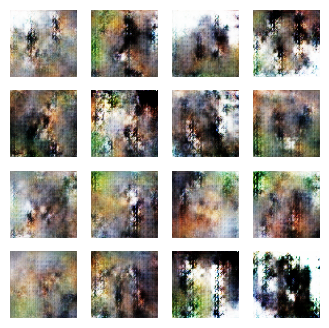

 70%|██████▉   | 699/1000 [59:29<25:10,  5.02s/it]

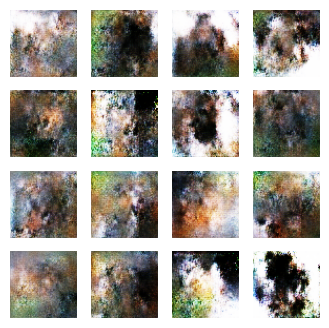

 71%|███████   | 709/1000 [1:00:19<24:22,  5.03s/it]

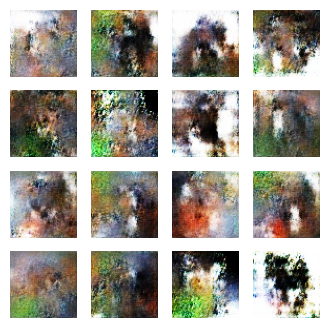

 72%|███████▏  | 719/1000 [1:01:10<23:30,  5.02s/it]

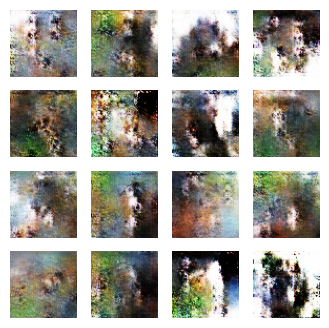

 73%|███████▎  | 729/1000 [1:02:01<22:40,  5.02s/it]

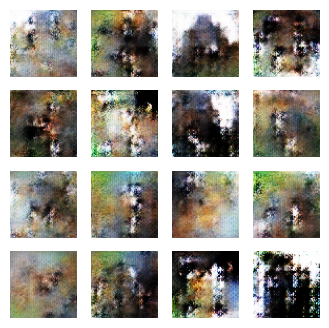

 74%|███████▍  | 739/1000 [1:02:52<21:52,  5.03s/it]

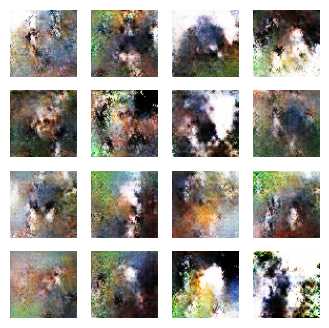

 75%|███████▍  | 749/1000 [1:03:43<20:59,  5.02s/it]

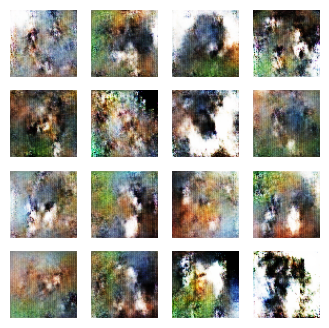

 76%|███████▌  | 759/1000 [1:04:34<20:09,  5.02s/it]

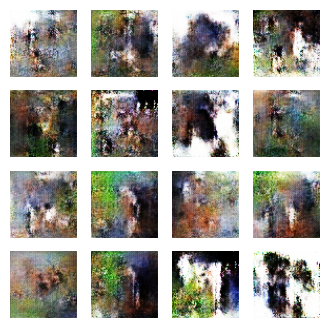

 77%|███████▋  | 769/1000 [1:05:25<19:20,  5.02s/it]

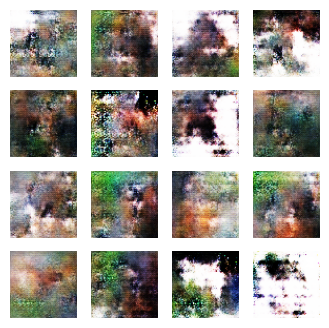

 78%|███████▊  | 779/1000 [1:06:16<18:29,  5.02s/it]

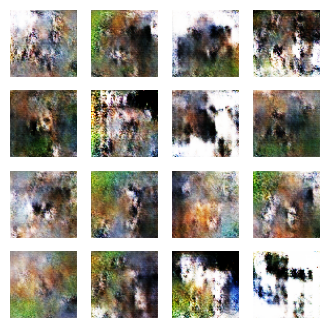

 79%|███████▉  | 789/1000 [1:07:06<17:39,  5.02s/it]

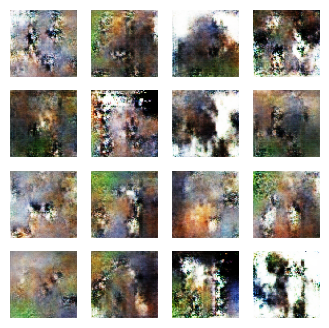

 80%|███████▉  | 799/1000 [1:07:57<16:49,  5.02s/it]

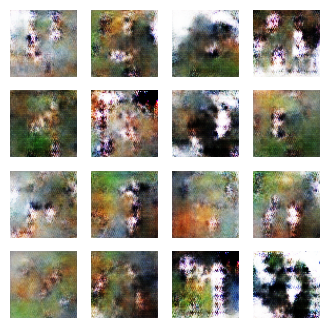

 81%|████████  | 809/1000 [1:08:48<15:58,  5.02s/it]

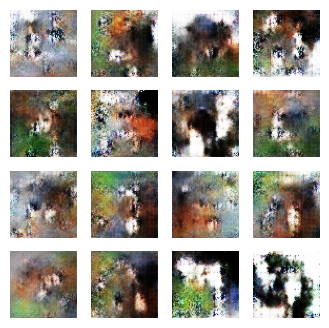

 82%|████████▏ | 819/1000 [1:09:39<15:08,  5.02s/it]

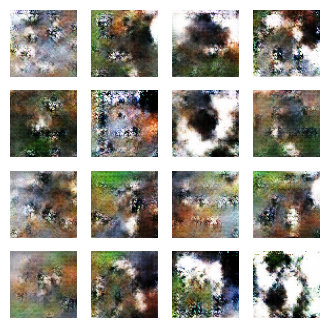

 83%|████████▎ | 829/1000 [1:10:30<14:20,  5.03s/it]

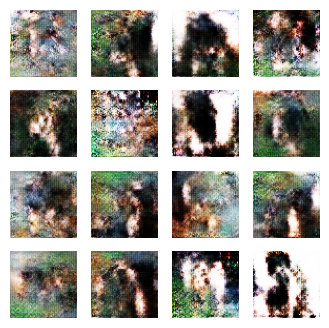

 84%|████████▍ | 839/1000 [1:11:20<13:27,  5.02s/it]

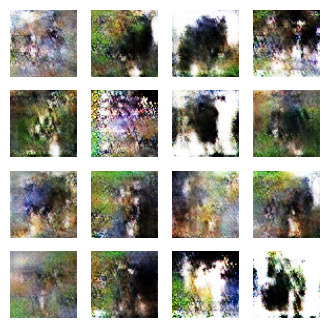

 85%|████████▍ | 849/1000 [1:12:11<12:37,  5.02s/it]

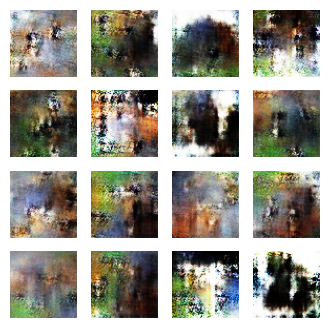

 86%|████████▌ | 859/1000 [1:13:02<11:48,  5.03s/it]

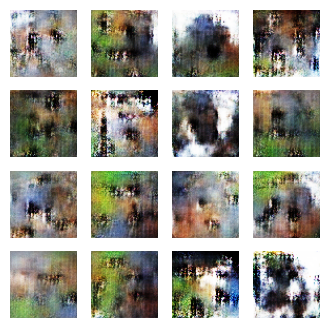

 87%|████████▋ | 869/1000 [1:13:53<10:57,  5.02s/it]

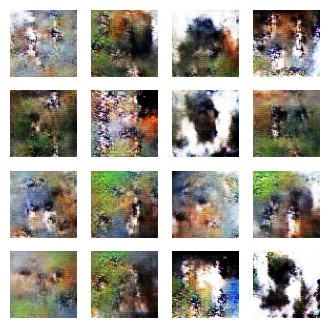

 88%|████████▊ | 879/1000 [1:14:44<10:07,  5.02s/it]

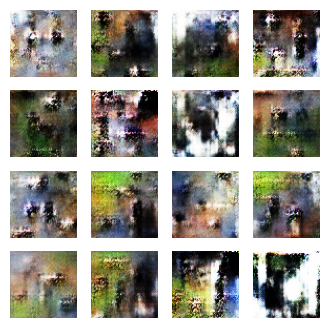

 89%|████████▉ | 889/1000 [1:15:35<09:17,  5.03s/it]

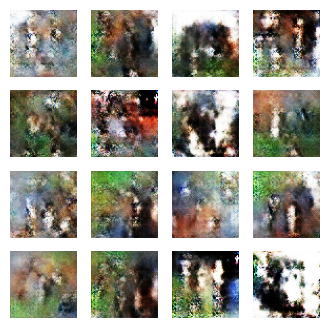

 90%|████████▉ | 899/1000 [1:16:25<08:26,  5.02s/it]

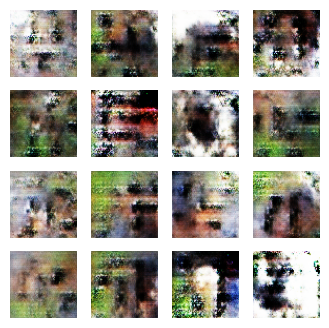

 91%|█████████ | 909/1000 [1:17:17<07:37,  5.02s/it]

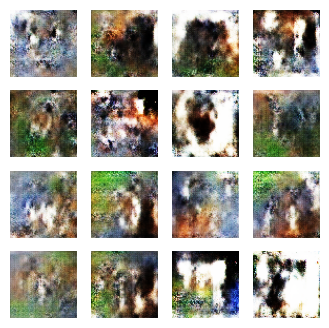

 92%|█████████▏| 919/1000 [1:18:07<06:47,  5.03s/it]

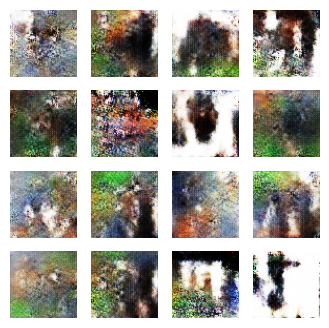

 93%|█████████▎| 929/1000 [1:18:58<05:56,  5.02s/it]

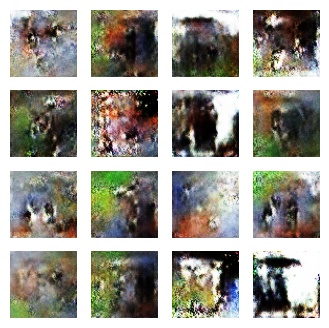

 94%|█████████▍| 939/1000 [1:19:49<05:06,  5.02s/it]

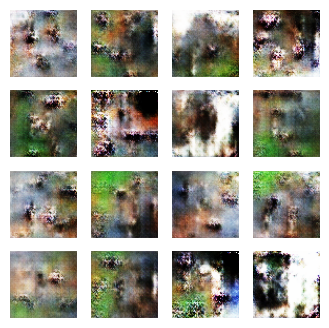

 95%|█████████▍| 949/1000 [1:20:40<04:16,  5.03s/it]

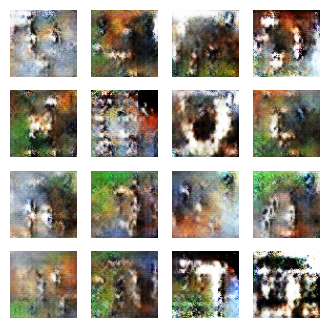

 96%|█████████▌| 959/1000 [1:21:31<03:25,  5.02s/it]

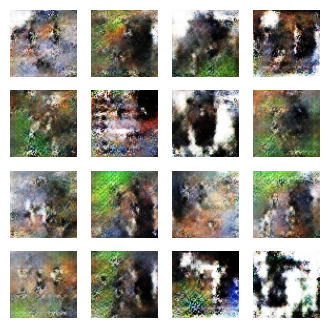

 97%|█████████▋| 969/1000 [1:22:22<02:35,  5.02s/it]

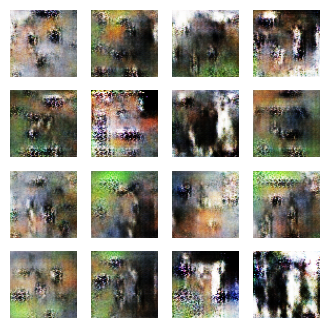

 98%|█████████▊| 979/1000 [1:23:12<01:45,  5.02s/it]

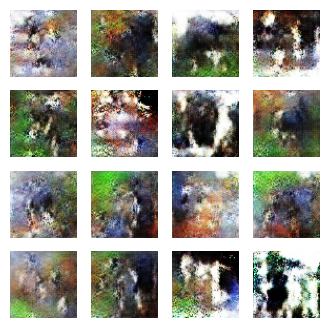

 99%|█████████▉| 989/1000 [1:24:03<00:55,  5.02s/it]

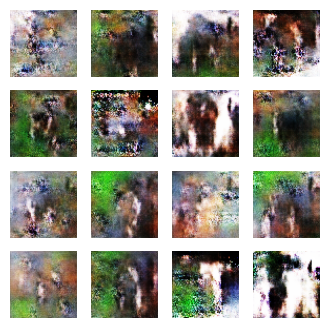

100%|█████████▉| 999/1000 [1:24:54<00:05,  5.02s/it]

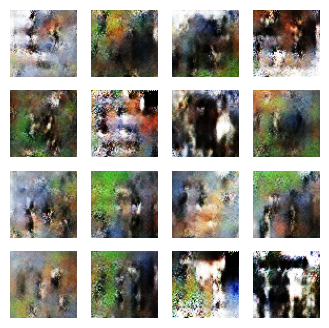

100%|██████████| 1000/1000 [1:25:00<00:00,  5.10s/it]


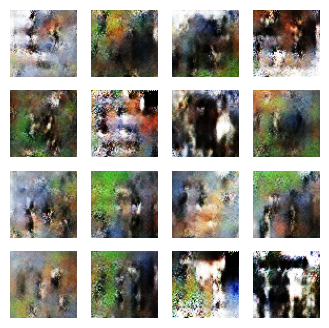

In [ ]:
EPOCHS = 100
BUFFER_SIZE = 60000
BATCH_SIZE = 256

train_dataset = tf.data.Dataset.from_tensor_slices(images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

train(train_dataset, EPOCHS)

  <h2 style="font-family: 'Arial', sans-serif; margin: 0;">
    Evaluating Results
  </h2>


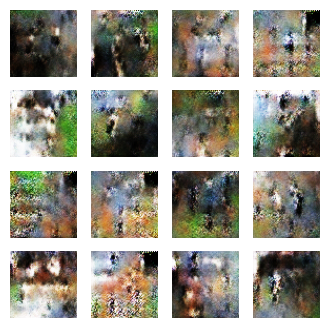

In [ ]:
num_images = 16
noise = tf.random.normal([num_images, noise_dim])
generated_images = generator(noise, training=False)

fig = plt.figure(figsize=(4, 4))

for i in range(generated_images.shape[0]):
    plt.subplot(4, 4, i + 1)
    plt.imshow((generated_images[i].numpy() * 127.5 + 127.5).astype(np.uint8))
    plt.axis('off')

plt.show()

In [ ]:
def create_gif(image_path_pattern, gif_path):
    import glob
    with imageio.get_writer(gif_path, mode='I') as writer:
        filenames = sorted(glob.glob(image_path_pattern))
        for filename in filenames:
            image = imageio.imread(filename)
            writer.append_data(image)
    print(f"GIF saved to {gif_path}")

In [ ]:
create_gif('image_at_epoch_{10}.png', 'training_progress.gif')

GIF saved to training_progress.gif


In [ ]:
generator.save('dog_generator_model.h5')
discriminator.save('dog_discriminator_model.h5')